## Introduction

The objective of this notebook is to show how common computer vision algorithms can be simply applied to remote sensing data. As ever with data science, much of the challenge lies in mapping real world data to an algorithm and back again, and this notebook aims to show a clear method of taking geospatial data into a more abstract reference frame that's better suited for analysis, and then back to the geospatial domain.

By using only 3 functions from Scikit Image and Scikit Learn, we can generate features that are highlighted on the map below. The 3 functions used are:
- `sklearn.preprocessing: StandardScaler`
- `sklearn.cluster: DBSCAN`
- `skimage.measure: find_contours`
All of the other code presented is really focused on transforming geospatial data to the domain of an image and then back again.

The workflow we'll follow can be summarised as:
- define area of interest (AOI) using the bounding north, west, south and eastern points of a rectangle
- validate that area on a map
- trial the DBSCAN clustering algorithm in a configurations on different types of data for a small portion of the AOI to settle on a clustering method
- apply the method over the whole AOI
- view the results on a map

Start with a bounding box:

In [2]:
w, s, e, n = -117.9835, 34.1462, -117.9827, 34.1468

We'll use Shapely to encode the shape set by those 4 corners, and then visualise the shape in Folium on the map to validate we're working in the expected region.

In [3]:
from shapely.geometry import box as geometry_from_bounding_box
from vdp_python_tools.visualize import visualize_geometry_on_map

boundary = geometry_from_bounding_box(w, s, e, n)

visualize_geometry_on_map(boundary)

Next, we define some functions to visualise the tiles we're using. In the the first notebook within the `notebooks/basics` folder in this repository, I showed how to go from a latitude and longitude coordinate, to a tile coordinate, and how that's used to source an image. The two functions below take the `boundary` geometry we defined above, and generate all of the map tiles that overlap that boundary at zoom level 21. Doing this, we can see on the map that we're going to be using 16 tiles, and that most of those cover buildings. 

In [4]:
import geopandas as gpd
from vdp_python_tools.tile_math import geometry_from_bounding_box, deg2num, num2deg, get_tile_boundary, tiles_in_polygon
import folium

def get_tile_boundary(x, y, zoom):
    w, s = num2deg(x, y, zoom)
    e, n = num2deg(x+1, y+1, zoom)
    tile_boundary = geometry_from_bounding_box(w, s, e, n)
    return tile_boundary



gdf_tiles = tiles_in_polygon(boundary, 21, output_format="GeoDataFrame")

lon, lat = boundary.centroid.coords[0]
m = folium.Map(location=[34.1465, -117.9831], zoom_start=20, max_zoom=21, min_zoom=19)

folium.TileLayer(
    "https://vdp-evaluation.herokuapp.com/GetOrthoImageTile/bluesky-ultra/{z}/{x}/{y}",
    attr="Vexcel Data Program", max_native_zoom=21, max_zoom=21
).add_to(m)

folium.GeoJson(
    gdf_tiles.to_json(),
).add_to(m)
m

To get started, we'll just use a single tile and examine the output from applying some machine learning algorithms on that tile.

In [6]:
x_tile, y_tile, zoom = gdf_tiles.iloc[1][['x', 'y', 'zoom']]
x_tile, y_tile, zoom 

(361272, 836714, 21)

Define the tile service endpoint that we're using. This notebook uses the evaluation endpoint, but if you're an existing Vexcel Data Program customer, you could substitute the production URL. The API endpoint below is a publicly available tile service that only returns tiles within a small area. It will allow anyone to follow along with the workflow below, but won't return any data outside of these boundaries.

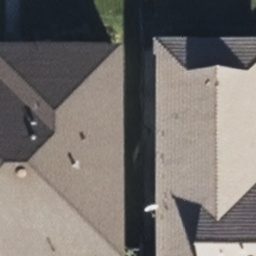

In [7]:
import io
import requests
from PIL import Image

tile_service_endpoint = "https://vdp-evaluation.herokuapp.com/{api}/{layer}/{z}/{x}/{y}"

response = requests.get(tile_service_endpoint.format(
    x=x_tile, y=y_tile, z=21, api="GetOrthoImageTile", layer="bluesky-ultra"
))

image = Image.open(io.BytesIO(response.content))
image

If you're using another source of spatial data, you could also use that. However note that this endpoint does return a Digital Surface Model which encodes elevation, so you might need to make some changes by removing references to the DSM.



Since we're going to be pulling a lot of tiles later on, let's define a function to handle that.

In [8]:
def get_tile_array(x, y, z, api, layer):
    url = f"https://vdp-evaluation.herokuapp.com/{api}/{layer}/{z}/{x}/{y}"
    response = requests.get(url)
    image = Image.open(io.BytesIO(response.content))
    return np.array(image)


All of the imagery captured and served from the Vexcel Data Program API has elevation data associated with it. For every pixel that has an color, there is also a pixel that represents the elevation.

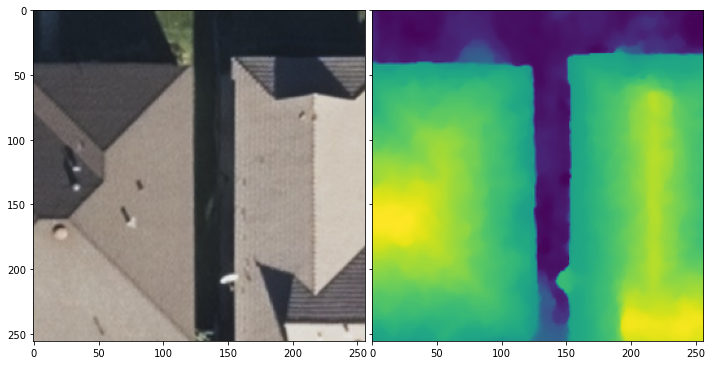

In [9]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import ImageGrid


ortho_tile_array = get_tile_array(x_tile, y_tile, zoom, "GetOrthoImageTile", "bluesky-ultra")
dsm_tile_array = get_tile_array(x_tile, y_tile, zoom, "GetDSMTile", "bluesky-ultra")

fig = plt.figure(figsize=(12., 12.))
grid = ImageGrid(fig, 111, nrows_ncols=(1, 2), axes_pad=0.1)

grid[0].imshow(ortho_tile_array)
grid[1].imshow(dsm_tile_array, )
plt.show()

Below, we import two algorithms:

- StandardScaler: this normalises the data. It means that the ML algorithm we use should perform similarly on tiles at any elevation 
- DBSCAN: a simple clustering algorithm that starts randomly grabbing pixels that are close in value if they're within a certain range (eps parameter) and if the required number of pixels are all grabbed by the increasing cluster (more than min_sample) then that group of pixels gets assigned a label designating them in a single cluster. See the animation in the GIF below.

In [10]:
from IPython.display import HTML
HTML('<img src="https://dashee87.github.io/images/DBSCAN_tutorial.gif">')

In [11]:
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import DBSCAN, KMeans
import numpy as np



Since DBSCAN uses random processes, let's set the random seed to 0 to ensure that this is all reproducible

In [12]:
np.random.seed(0)

Found 2 segments


<Figure size 576x576 with 0 Axes>

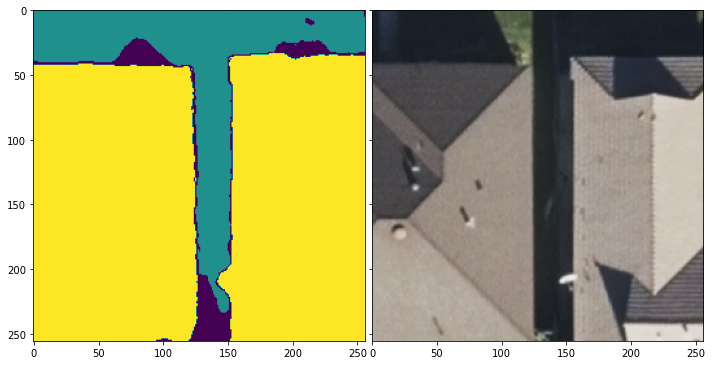

In [13]:
def segment_array(array, clusterer, with_labels=False):
    w, h = array.shape[:2]
    # the DSM comes down as a 256 x 256 array, whereas the RGB and CIR come down as 256 x 256 x 4, so they have 
    # different shape formats (256, 256) vs (256, 256, 4)
    d = 1 if len(array.shape) == 2 else array.shape[2]
    # this takes the grid of pixels and flattens them all into a list
    pixels = array.reshape(w*h, d)
    # this function scales all of the values into a common range to make sure it operates consistently over 
    # a variety of color ranges and elevations
    pixels_scaled = StandardScaler().fit_transform(pixels)

    clustering = clusterer.fit(pixels_scaled)
    
    return clustering.labels_.reshape(w, h), set(clustering.labels_)
fig = plt.figure(figsize=(8, 8))
clusterer = DBSCAN(eps=0.02, min_samples=300)
segmented_image, labels = segment_array(dsm_tile_array, clusterer)
# -1 from the count because the labels include a "-1" value for unclustered pixels
print(f"Found {len(labels)-1} segments")

fig = plt.figure(figsize=(12., 12.))
grid = ImageGrid(fig, 111, nrows_ncols=(1, 2), axes_pad=0.1)

grid[0].imshow(segmented_image)
grid[1].imshow(ortho_tile_array)
plt.show()

What the image on the left above shows is 2 clusters of pixels. Green is all the pixels on the ground, yellow covers the pixels that make up the roofs. The dark blue pixels are "unclustered" as DBSCAN couldn't find a cluster for them based on the paramters set.

To see this more clearly, see the range of plots below.

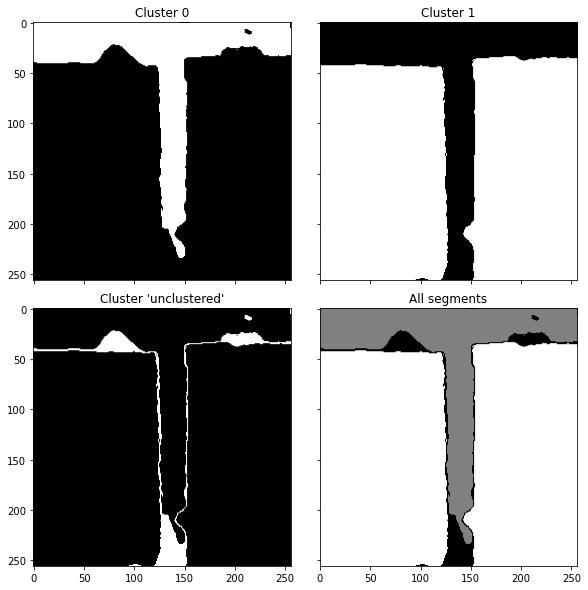

In [14]:
from mpl_toolkits.axes_grid1 import ImageGrid

fig = plt.figure(figsize=(10, 10))
grid = ImageGrid(fig, 111, 
                 nrows_ncols=(2, 2),  
                 axes_pad=0.4,  
                 )

for ax, (title, im) in zip(grid, [(f"Cluster {i}", segmented_image == i) for i in set(labels)] + [(f"All segments", segmented_image)]):
    # Iterating over the grid returns the Axes.
    ax.set_title(title.replace("-1", "'unclustered'"))
    ax.imshow(im, cmap="gray")
    
plt.show()

The white sections of each image are members of the same cluster. Notice that in Cluster 1, the two roof sections are regarded as a single cluster. This is because at the moment, DBSCAN is ignorant of anything spatial, we've just taken the 2D pixel array and flattened it, removing crucial information.

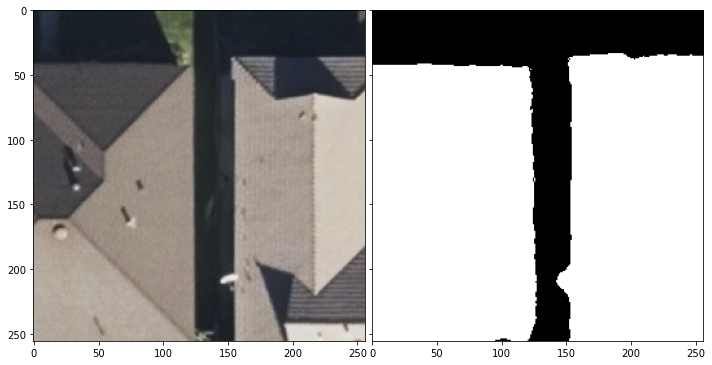

In [15]:
fig = plt.figure(figsize=(12., 12.))
grid = ImageGrid(fig, 111, nrows_ncols=(1, 2), axes_pad=0.1)

grid[0].imshow(ortho_tile_array)
grid[1].imshow(segmented_image == 1, cmap="gray")


plt.show()

To correct for this, we can just add the spatial values back into the array. Now when we flatten the array, the spatial information will be maintained.

In [16]:
SPACE_256_256 = np.zeros([256, 256, 2])

for i in range(256):
    for j in range(256):
        SPACE_256_256[i][j] = [i, j]

def space_array(array):
    # the DSM comes down as a 256 x 256 array, whereas the RGB and CIR come down as 256 x 256 x 4, so they have 
    # different shape formats (256, 256) vs (256, 256, 4)
    if len(array.shape) == 2:
        w, h = array.shape
        array_with_space = np.zeros((w, h, 3))
        
        array_with_space[:, :, 0] = array
        array_with_space[:, :, 1:] = SPACE_256_256
        return array_with_space
    w, h, d = array.shape
    array_with_space = np.zeros((w, h, d + 2))
    array_with_space[:, :, :d] = array
    array_with_space[:, :, d:] = SPACE_256_256
    return array_with_space

clusterer_for_dsm_with_space = DBSCAN(eps=0.1, min_samples=80)
dsm_tile_array_with_space = space_array(dsm_tile_array)
segmented_image, labels = segment_array(dsm_tile_array_with_space, clusterer_for_dsm_with_space)
print(f"Found {len(labels)} segments")

Found 8 segments


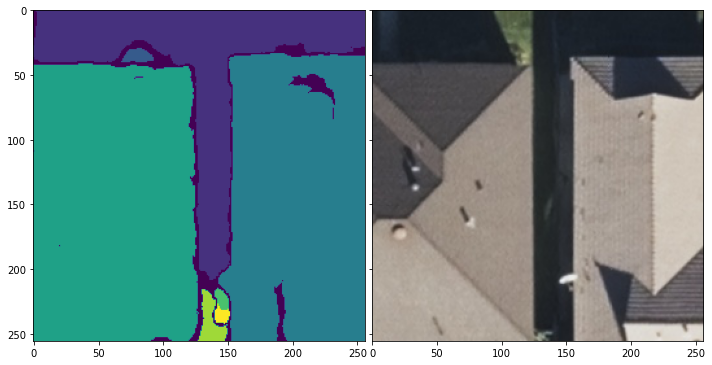

In [17]:
fig = plt.figure(figsize=(12., 12.))
grid = ImageGrid(fig, 111, nrows_ncols=(1, 2), axes_pad=0.1)

grid[0].imshow(segmented_image)
grid[1].imshow(ortho_tile_array)


plt.show()

Now you can see that the image above on the left has a different color for each roof. By including the spatial information, DBSCAN distinguished between pixels that were far apart spatially.

The other challenge of working purely with elevation data is that there are cases where two adjacent objects that are visually distinct have a continous combined elevation profile, and so appear to be continous, see the example below where the roof segment continues into the tree.

Found 25 segments


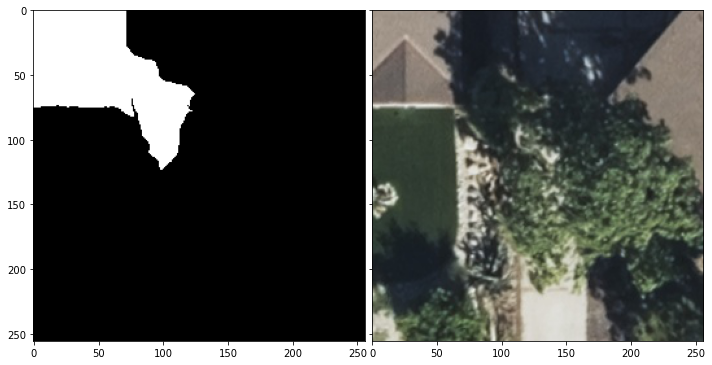

In [18]:
x_tile_tree, y_tile_tree = 361272+3, 836714+3

ortho_tile_array_tree = get_tile_array(x_tile_tree, y_tile_tree, zoom, "GetOrthoImageTile", "bluesky-ultra")
dsm_tile_array_tree = get_tile_array(x_tile_tree, y_tile_tree, zoom, "GetDSMTile", "bluesky-ultra")

clusterer_for_dsm_with_space = DBSCAN(eps=0.1, min_samples=80)
dsm_tile_array_with_space = space_array(dsm_tile_array_tree)
segmented_image, labels = segment_array(dsm_tile_array_with_space, clusterer_for_dsm_with_space)
print(f"Found {len(labels)} segments")

fig = plt.figure(figsize=(12., 12.))
grid = ImageGrid(fig, 111, nrows_ncols=(1, 2), axes_pad=0.1)

grid[0].imshow(segmented_image == 0, cmap="gray")
grid[1].imshow(ortho_tile_array_tree)


plt.show()

In the image on the top left, we can see the white pixels forming that cluster extending into the tree. To rectify this, we just add the RGB imagery to the array and the clustering algorithm gets better at distinguishing between the tree and the roof.

Found 15 segments


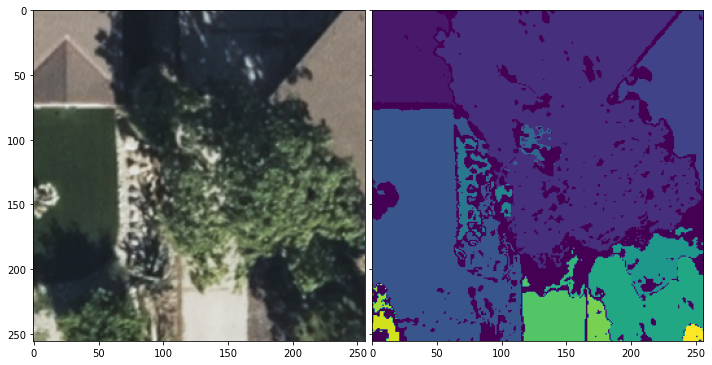

In [19]:
dsm_and_ortho_array = np.zeros([256, 256, 4])
dsm_and_ortho_array[:,:,:3] = ortho_tile_array_tree
dsm_and_ortho_array[:,:,3] = dsm_tile_array_tree
dsm_and_ortho_array = space_array(dsm_and_ortho_array)

clusterer_for_dsm_and_ortho = DBSCAN(eps=0.3, min_samples=80)
segmented_image, labels = segment_array(dsm_and_ortho_array, clusterer_for_dsm_and_ortho)
print(f"Found {len(labels)-1} segments")

fig = plt.figure(figsize=(12., 12.))
grid = ImageGrid(fig, 111, nrows_ncols=(1, 2), axes_pad=0.1)

grid[0].imshow(ortho_tile_array_tree)
grid[1].imshow(segmented_image)


plt.show()

So now we're at a point in the analysis where we've got a nice method for segmenting images. The final step within the reference frame of the images are to draw lines around each of the segements. To do this, we just use sklearn.measure.find_contours

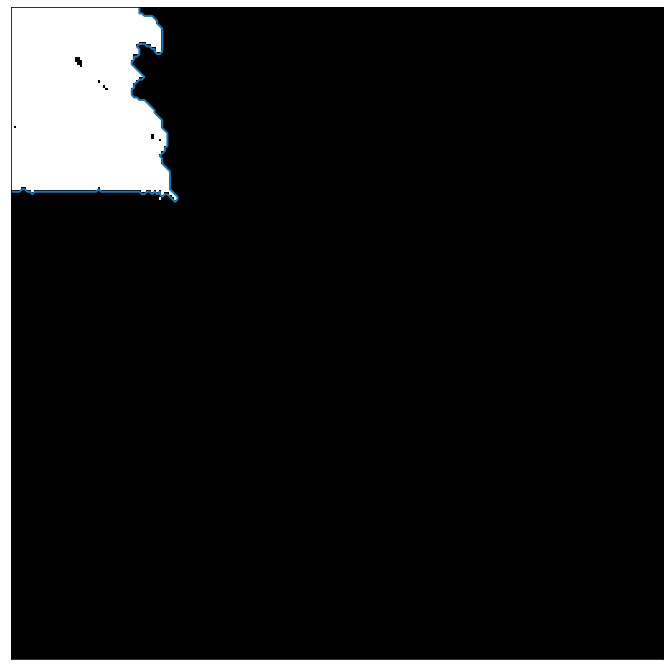

In [21]:
from skimage import data
from skimage import measure

import numpy as np
import matplotlib.pyplot as plt

mask = segmented_image == 0
contours = measure.find_contours(mask, level=0)

fig = plt.figure(figsize=(12., 12.))
# Display the image and plot all contours found
plt.imshow(mask, interpolation='nearest', cmap="gray")

for n, contour in enumerate(contours):
    if len(contour) < 10: continue
    plt.plot(contour[:, 1], contour[:, 0], linewidth=2)

plt.axis('image')
plt.xticks([])
plt.yticks([])
plt.show()


What you can sort of make out in that image is that there are no contours going around the edge of that white feature which is the roof. We want that boundary, so repeat the above but with some padding around the image to give the contour finder a well defined edge.

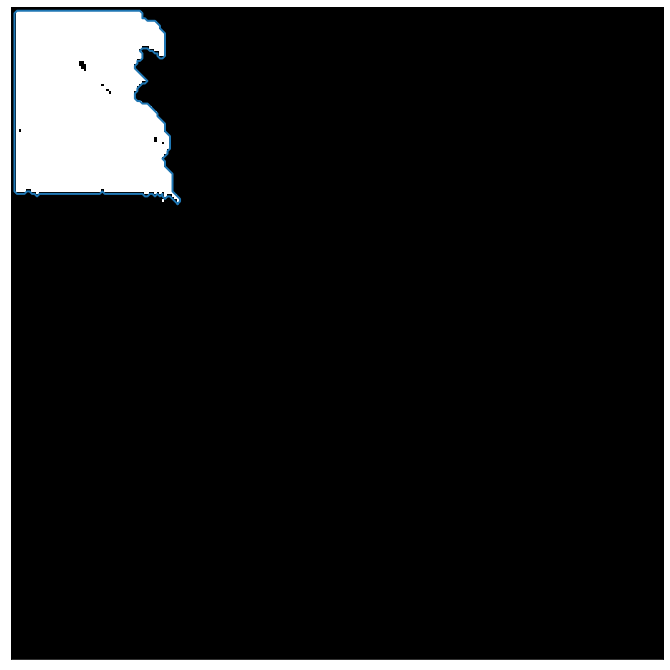

In [22]:
from skimage import data
from skimage import measure

import numpy as np
import matplotlib.pyplot as plt

padded_mask = np.pad(mask, 2)

contours = measure.find_contours(padded_mask, level=0)
fig = plt.figure(figsize=(12., 12.))

# Display the image and plot all contours found
plt.imshow(padded_mask, interpolation='nearest', cmap="gray")

for n, contour in enumerate(contours):
    if len(contour) < 10: continue
    plt.plot(contour[:, 1], contour[:, 0], linewidth=2)

plt.axis('image')
plt.xticks([])
plt.yticks([])
plt.show()

Since we're going to be using that code to pull out a contour a lot, define a function and run it over all the segments which make up the imagem

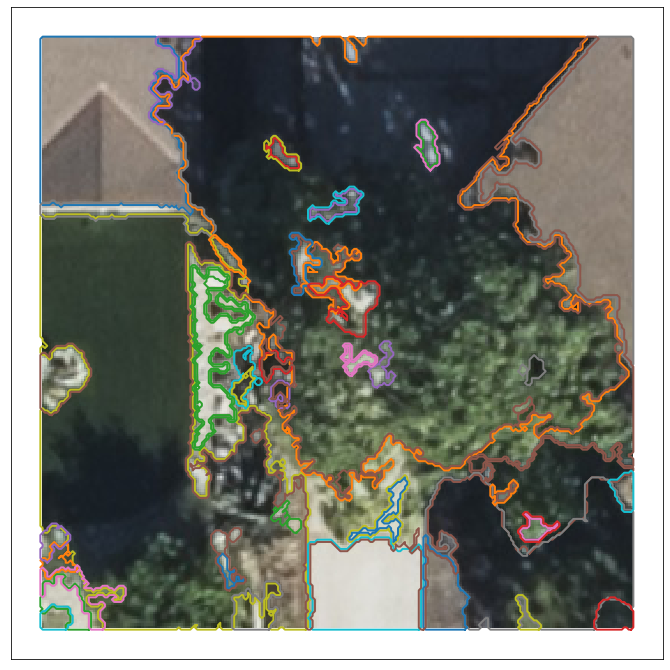

In [23]:
def extract_contours(segmented_image, labels):
    contours = []

    for label in labels:  
        mask = segmented_image == label
        padded_mask = np.pad(mask, 2)
        contours.extend([contour - (2,2) for contour in measure.find_contours(padded_mask, level=0)])
        
    return contours

contours = extract_contours(segmented_image, labels)

# Display the image and plot all contours found
fig = plt.figure(figsize=(12., 12.))

plt.imshow(ortho_tile_array_tree, interpolation='nearest')

for n, contour in enumerate(contours):
    if len(contour) < 40: continue
    plt.plot(contour[:, 1], contour[:, 0], linewidth=2)

plt.axis('image')
plt.xticks([])
plt.yticks([])
plt.show()
    

At this point, all of the machine learning work has been done. There are certainly improvements to be made, but the goal with this notebook is to show how to get from geospatial to pure machine learning, and also back again which is what the next section is about.

The contours above are just coordinate sequences within the 256 x 256 pixel reference frame of the image. E.g the sequence below encodes a line starting from row 0, column 50 to row 1, column 50, to row 2 etc. 

In [24]:
contours[0][:4]

array([[76., 64.],
       [75., 63.],
       [74., 62.],
       [73., 61.]])

Now what we do is take the coordinates from the pixel reference frame, and combine what we know about where these pixels are located on earth. The functions below take care of all of the mathematics.

In [25]:
import math

def num2deg(xtile, ytile, zoom):
    n = 2.0 ** zoom
    lon_deg = xtile / n * 360.0 - 180.0
    lat_rad = math.atan(math.sinh(math.pi * (1 - 2 * ytile / n)))
    lat_deg = math.degrees(lat_rad)
    return (lon_deg, lat_deg)

def pixel_to_coord(p_x, p_y, bounds, deg_per_pixel_wide, deg_per_pixel_high):
    (left, bottom, right, top) = bounds
    c_x = left + p_x*deg_per_pixel_wide
    c_y = top - p_y*deg_per_pixel_high
    return [ c_x, c_y]

def tile_bounds(x, y, zoom):
    # Min and max in terms of lat and lon
    # Max lon actually corresponds to min Y
    minx, maxy = num2deg(x, y, zoom) 
    maxx, miny = num2deg(x+1, y+1, zoom)
    
    return [minx, miny, maxx, maxy]

def degrees_per_pixel(bounds, pixels_wide, pixels_high):
    width_in_deg = abs(bounds[2] - bounds[0])
    height_in_deg = abs(bounds[3] - bounds[1])

    deg_per_pixel_wide = width_in_deg/pixels_wide
    deg_per_pixel_high = height_in_deg/pixels_high
    return deg_per_pixel_wide, deg_per_pixel_high

bounds = tile_bounds(x_tile_tree, y_tile_tree, zoom)
deg_per_pixel_wide, deg_per_pixel_high = degrees_per_pixel(bounds, 256, 256)

Again, we use Shapely to handle all of the spatial objects. We also use GeoPandas to create a GeoDataFrame containing the geometries. GeoPandas then creates a GeoJSON read by Folium to display a HTML map in the notebook.

In [26]:
from shapely.geometry import Polygon

geometries = [Polygon([pixel_to_coord(x, y, bounds, deg_per_pixel_wide, deg_per_pixel_high) for y, x in contour])  for contour in contours if len(contour) >= 40]
gdf_contours = gpd.GeoDataFrame(geometry=geometries)

In [27]:
import folium
lon, lat = boundary.centroid.coords[0]
m = folium.Map(location=num2deg(x_tile_tree, y_tile_tree, 21)[::-1], tiles="cartodbpositron", zoom_start=20, max_zoom=21)

folium.TileLayer(
    "https://vdp-evaluation.herokuapp.com/GetOrthoImageTile/bluesky-ultra/{z}/{x}/{y}",
    attr="Vexcel Data Program", max_native_zoom=22, max_zoom=22, name="bluesky-ultra", min_zoom=19
).add_to(m)

folium.GeoJson(
    gdf_contours.to_json(),
).add_to(m)
m

## Putting it all together

So far, we have a set of contours on map that highlight features, for a single tile. To do this over large area, we just repeat for multiple tiles. We can also add in some extra steps to ensure that the elevation data within each contour is being captured. The function below does the following, for every map tile in our AOI.
1. gets the spatial extent of the map tile and calculates how many degrees wide and high each image is. This information is used to transform the pixel coordinates to geospatial coordinates
2. gets the tile arrays for DSM and Ortho imagery for this tile
3. preprocesses the data into a single array with spatial information
4. instantiates the clustering algorithm
5. segments the image with the clustering algorithm
6. generates the contours
7. transforms the contours from their 256x256 image reference frame to the spherical earth reference frame (yes, the earth isn't a perfect sphere, but the standard reference frame for map tiles makes that assumption)

In [28]:
polygon_bbox_lat_lon = boundary.bounds
bbox_in_tile_numbers = [*deg2num(*polygon_bbox_lat_lon[:2], 21), *deg2num(*polygon_bbox_lat_lon[2:], 21)]

x_tiles = list(range(bbox_in_tile_numbers[0], bbox_in_tile_numbers[2] + 1))
y_tiles = list(range(bbox_in_tile_numbers[3], bbox_in_tile_numbers[1] + 1))

n_x_tiles = len(x_tiles)
n_y_tiles = len(y_tiles)

def extract_features_from_tile(x_tile, y_tile, zoom, features):
    bounds = tile_bounds(x_tile, y_tile, zoom)
    deg_per_pixel_wide, deg_per_pixel_high = degrees_per_pixel(bounds, 256, 256)
    
    ortho_tile_array = get_tile_array(x_tile, y_tile, zoom, "GetOrthoImageTile", "bluesky-ultra")
    dsm_tile_array = get_tile_array(x_tile, y_tile, zoom, "GetDSMTile", "bluesky-ultra")
    
    dsm_and_ortho_array = np.zeros([256, 256, 4])
    dsm_and_ortho_array[:,:,:3] = ortho_tile_array
    dsm_and_ortho_array[:,:,3] = dsm_tile_array
    dsm_and_ortho_array = space_array(dsm_and_ortho_array)

    clusterer_for_dsm_and_ortho = DBSCAN(eps=0.2, min_samples=80) 

    
    segmented_image, labels = segment_array(dsm_and_ortho_array, clusterer_for_dsm_and_ortho)
    
    contours = []

    for label in set(labels):
        mask = segmented_image == label
        height = dsm_tile_array[mask].mean()
        padded_mask = np.pad(mask, 2)
        contours.extend([(contour - (2,2), label, height) for contour in measure.find_contours(padded_mask, level=0)])
        
    
    for contour, contour_label, height in contours:
        geometry = Polygon([pixel_to_coord(x, y, bounds, deg_per_pixel_wide, deg_per_pixel_high) for y, x in contour])
        
        #coords = coords + [coords[0]]
        features.append({
          "geometry": geometry, "properties": {"height": height, "label": label}
          }
        )
    return features

Finally, we run the function above through a for loop, create a GeoDataFrame and pass that to Folium to visualise the feautures where the color varies from yellow (minimum elevation, ground) to dark blue (highest elevation, trees).

In [29]:
features = [
    
]

for i_x, x in enumerate(x_tiles):
    for i_y, y in enumerate(y_tiles):
        extract_features_from_tile(x, y, zoom, features)

gdf_features = gpd.GeoDataFrame.from_features(features)

import branca

colorscale = branca.colormap.linear.YlGnBu_09.scale(gdf_features.height.min(), gdf_features.height.max())

def style_function(feature):
    return {
        "fillOpacity": 0.8,
        "weight": 0.1,
        "color": "black",
        "fillColor": colorscale(feature['properties']['height'])
    }


final_map = folium.Map(location=[34.1465, -117.9831], zoom_start=20, max_zoom=21, min_zoom=19)

folium.GeoJson(
    gdf_features.to_json(),
    style_function=style_function,
    name="features",
).add_to(final_map)

folium.TileLayer(
    "https://vdp-evaluation.herokuapp.com/GetOrthoImageTile/bluesky-ultra/{z}/{x}/{y}",
    attr="Vexcel Data Program", max_native_zoom=22, max_zoom=22, name="bluesky-ultra", min_zoom=19
).add_to(final_map)
final_map.fit_bounds(boundary.bounds)
final_map

Hopefully after reading through this notebook, you have a greater understanding of how to work with geospatial data to do machine learning tasks like image classification and feature extraction. I also hope that you can see the advantage of using multiple types of data captured from remote sensing. Using RGB or elevation alone can lead to an incomplete picture of the world. The better the information we can give to algorithms, the better the results.

Some potential next steps if you wanted to continue this analysis:
- investigate alternatives to DBSCAN, including the use of more advanced classifiers including supervised learning  
- use PostGIS to merge the geometries that neighbor each other when split by tiles. PostGIS' support of 3D geometries mean methods like intersect is available in 3D unlike with GeoPandas
- add the elevation value to the contours to create 3D polygons to generate 3D models of buildings and trees